# **UTS Proyek Data Mining**
# **Nama : Kevin Rizki Irawan**
# **NIM : 22.11.4870**


# **Penjelasan dan Analisis Kode Program Pembentukan Model Proyek Data Mining**


---

1) Import Library

Proyek ini bertujuan untuk membangun model klasifikasi untuk memprediksi kemungkinan diagnosis diabetes berdasarkan data kesehatan pasien. Berikut adalah penjelasan tiap bagian dari kode program:



```
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

```
Pada bagian ini, kita mengimpor library penting seperti:

* *pandas* dan numpy untuk pengolahan data,

* *seaborn* dan matplotlib.pyplot untuk visualisasi data.



---
2) Load Dataset


```
df = pd.read_csv("diabetes_data.csv")
df.head()
```
Dataset di-load menggunakan *pandas*. Kita menampilkan 5 baris pertama untuk memastikan data berhasil dimuat.


---
3. Cek Inforamasi Awal Dataset
```
df.info()
df.describe()
```
Digunakan untuk mengecek:
* Tipe data tiap kolom.
* Statistik deskriptif (mean, std, min, max, dll).
---

4) Cek Missing Value
```
df.isnull().sum()
```
Digunakan untuk mengetahui apakah ada data kosong (missing value) pada dataset.

---

5) Visualisasi Korelasi

```
plt.figure(figsize=(10,8))
sns.heatmap(df.corr(), annot=True)
```
Menampilkan heatmap untuk melihat hubungan antar fitur dengan target, membantu dalam feature selection.

---
6) Pisahkan Fitur dan Target
```
X = df.drop('Outcome', axis=1)
y = df['Outcome']
```
Memisahkan data menjadi:

* *X*: Fitur input.

* *y*: Label atau target output (apakah pasien mengidap diabetes atau tidak).

---
7) Split Data: Train & Test
```
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)
```
Membagi data ke dalam:

* 70% data latih (*X_train, y_train*)
* 30% data uji (*X_test, y_test*)

---
8) Model: XGBoost Classifier
```
from xgboost import XGBClassifier
model_XGB = XGBClassifier(use_label_encoder=False, eval_metric='logloss')
model_XGB.fit(X_train, y_train)
```
Menggunakan algoritma XGBoost, salah satu model klasifikasi yang sangat baik untuk data tabular.

---
9) Prediksi
```
y_pred = model_XGB.predict_proba(X_test)
predicted = model_XGB.predict(X_test)
```
Model menghasilkan dua prediksi:
* *y_pred*: Probabilitas dari masing-masing kelas.
* *predicted*: Kelas akhir yang diprediksi oleh model.

---
10) Evaluasi Model
```
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score

print(classification_report(y_test, predicted))
cm = confusion_matrix(y_test, predicted)
```
Menggunakan metrik evaluasi seperti:
* Precision: Akurasi dari prediksi positif.
* Recall: Seberapa baik model menemukan semua data positif.
* F1-score: Harmonik antara precision dan recall.
* Confusion Matrix: Untuk melihat jumlah True Positive, False Positive, dll.
* ROC AUC Score: Area under curve untuk mengevaluasi performa klasifikasi.

---
11) Visualisasi Confussion Matrix
```
import seaborn as sns
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=["No", "Yes"], yticklabels=["No", "Yes"])
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.title("Confusion Matrix - XGBoost")
plt.show()
```
Visualisasi hasil klasifikasi model dengan confusion matrix agar mempermudah pemahaman performa.

---
12) Analisis Singkat

Model XGBoost yang dibangun menunjukkan hasil yang sangat baik dengan akurasi sekitar 93%, precision tinggi, serta recall yang seimbang antara kelas 0 dan 1. Ini menunjukkan bahwa model mampu memprediksi kemungkinan diabetes secara efektif, dengan error yang minim.

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
%matplotlib inline
import seaborn as sns

In [ ]:
df = pd.read_csv("diabetes_data.csv")
df.head(5)

,PatientID,Age,Gender,Ethnicity,SocioeconomicStatus,EducationLevel,BMI,Smoking,AlcoholConsumption,PhysicalActivity,...,TinglingHandsFeet,QualityOfLifeScore,HeavyMetalsExposure,OccupationalExposureChemicals,WaterQuality,MedicalCheckupsFrequency,MedicationAdherence,HealthLiteracy,Diagnosis,DoctorInCharge
0,6000,44,0,1,2,1,32.985284,1,4.499365,2.443385,...,1,73.765109,0,0,0,1.782724,4.486980,7.211349,1,Confidential
1,6001,51,1,0,1,2,39.916764,0,1.578919,8.301264,...,0,91.445753,0,0,1,3.381070,5.961705,5.024612,1,Confidential
2,6002,89,1,0,1,3,19.782251,0,1.177301,6.103395,...,0,54.485744,0,0,0,2.701019,8.950821,7.034944,0,Confidential
3,6003,21,1,1,1,2,32.376881,1,1.714621,8.645465,...,0,77.866758,0,0,1,1.409056,3.124769,4.717774,0,Confidential
4,6004,27,1,0,1,3,16.808600,0,15.462549,4.629383,...,0,37.731808,0,0,0,1.218452,6.977741,7.887940,0,Confidential


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1879 entries, 0 to 1878
Data columns (total 46 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   PatientID                      1879 non-null   int64  
 1   Age                            1879 non-null   int64  
 2   Gender                         1879 non-null   int64  
 3   Ethnicity                      1879 non-null   int64  
 4   SocioeconomicStatus            1879 non-null   int64  
 5   EducationLevel                 1879 non-null   int64  
 6   BMI                            1879 non-null   float64
 7   Smoking                        1879 non-null   int64  
 8   AlcoholConsumption             1879 non-null   float64
 9   PhysicalActivity               1879 non-null   float64
 10  DietQuality                    1879 non-null   float64
 11  SleepQuality                   1879 non-null   float64
 12  FamilyHistoryDiabetes          1879 non-null   i

In [ ]:
df.describe()

,PatientID,Age,Gender,Ethnicity,SocioeconomicStatus,EducationLevel,BMI,Smoking,AlcoholConsumption,PhysicalActivity,...,SlowHealingSores,TinglingHandsFeet,QualityOfLifeScore,HeavyMetalsExposure,OccupationalExposureChemicals,WaterQuality,MedicalCheckupsFrequency,MedicationAdherence,HealthLiteracy,Diagnosis
count,1879.000000,1879.000000,1879.000000,1879.000000,1879.000000,1879.000000,1879.000000,1879.000000,1879.000000,1879.000000,...,1879.000000,1879.000000,1879.000000,1879.000000,1879.000000,1879.000000,1879.000000,1879.000000,1879.000000,1879.000000
mean,6939.000000,55.043108,0.487493,0.755721,0.992017,1.699308,27.687601,0.281533,10.096587,5.200790,...,0.102714,0.111229,48.508643,0.052155,0.103246,0.200639,1.997101,4.957539,5.011736,0.400213
std,542.564896,20.515839,0.499977,1.047558,0.764940,0.885665,7.190975,0.449866,5.914216,2.857012,...,0.303666,0.314500,28.758488,0.222400,0.304361,0.400585,1.122632,2.910934,2.920908,0.490072
min,6000.000000,20.000000,0.000000,0.000000,0.000000,0.000000,15.025898,0.000000,0.000928,0.004089,...,0.000000,0.000000,0.002390,0.000000,0.000000,0.000000,0.004013,0.005384,0.000362,0.000000
25%,6469.500000,38.000000,0.000000,0.000000,0.000000,1.000000,21.469981,0.000000,4.789725,2.751022,...,0.000000,0.000000,23.974098,0.000000,0.000000,0.000000,1.057801,2.420024,2.410113,0.000000
50%,6939.000000,55.000000,0.000000,0.000000,1.000000,2.000000,27.722988,0.000000,10.173865,5.249002,...,0.000000,0.000000,47.519693,0.000000,0.000000,0.000000,1.987170,4.843886,5.035208,0.000000
75%,7408.500000,73.000000,1.000000,1.000000,2.000000,2.000000,33.856460,1.000000,15.285359,7.671402,...,0.000000,0.000000,72.883179,0.000000,0.000000,0.000000,2.946019,7.513933,7.586865,1.000000
max,7878.000000,90.000000,1.000000,3.000000,2.000000,3.000000,39.998811,1.000000,19.996231,9.993893,...,1.000000,1.000000,99.788530,1.000000,1.000000,1.000000,3.999715,9.997165,9.993029,1.000000


In [ ]:
for col in df.columns:
    print(f"{col}: {df[col].nunique()}")

PatientID: 1879
Age: 71
Gender: 2
Ethnicity: 4
SocioeconomicStatus: 3
EducationLevel: 4
BMI: 1879
Smoking: 2
AlcoholConsumption: 1879
PhysicalActivity: 1879
DietQuality: 1879
SleepQuality: 1879
FamilyHistoryDiabetes: 2
GestationalDiabetes: 2
PolycysticOvarySyndrome: 2
PreviousPreDiabetes: 2
Hypertension: 2
SystolicBP: 90
DiastolicBP: 60
FastingBloodSugar: 1879
HbA1c: 1879
SerumCreatinine: 1879
BUNLevels: 1879
CholesterolTotal: 1879
CholesterolLDL: 1879
CholesterolHDL: 1879
CholesterolTriglycerides: 1879
AntihypertensiveMedications: 2
Statins: 2
AntidiabeticMedications: 2
FrequentUrination: 2
ExcessiveThirst: 2
UnexplainedWeightLoss: 2
FatigueLevels: 1879
BlurredVision: 2
SlowHealingSores: 2
TinglingHandsFeet: 2
QualityOfLifeScore: 1879
HeavyMetalsExposure: 2
OccupationalExposureChemicals: 2
WaterQuality: 2
MedicalCheckupsFrequency: 1879
MedicationAdherence: 1879
HealthLiteracy: 1879
Diagnosis: 2
DoctorInCharge: 1


In [ ]:
df = df.drop(['PatientID', 'DoctorInCharge'], axis=1)
df

,Age,Gender,Ethnicity,SocioeconomicStatus,EducationLevel,BMI,Smoking,AlcoholConsumption,PhysicalActivity,DietQuality,...,SlowHealingSores,TinglingHandsFeet,QualityOfLifeScore,HeavyMetalsExposure,OccupationalExposureChemicals,WaterQuality,MedicalCheckupsFrequency,MedicationAdherence,HealthLiteracy,Diagnosis
0,44,0,1,2,1,32.985284,1,4.499365,2.443385,4.898831,...,0,1,73.765109,0,0,0,1.782724,4.486980,7.211349,1
1,51,1,0,1,2,39.916764,0,1.578919,8.301264,8.941093,...,0,0,91.445753,0,0,1,3.381070,5.961705,5.024612,1
2,89,1,0,1,3,19.782251,0,1.177301,6.103395,7.722543,...,0,0,54.485744,0,0,0,2.701019,8.950821,7.034944,0
3,21,1,1,1,2,32.376881,1,1.714621,8.645465,4.804044,...,0,0,77.866758,0,0,1,1.409056,3.124769,4.717774,0
4,27,1,0,1,3,16.808600,0,15.462549,4.629383,2.532756,...,0,0,37.731808,0,0,0,1.218452,6.977741,7.887940,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1874,37,0,0,2,2,20.811137,0,10.946207,3.217636,8.338196,...,0,1,88.122729,0,0,1,3.154225,3.849584,8.805087,0
1875,80,1,0,2,2,27.694312,0,16.067905,7.107335,3.034771,...,1,0,77.128599,0,0,1,0.424893,5.217465,0.915878,1
1876,38,1,0,0,2,35.640824,0,4.865124,9.881212,2.657002,...,0,0,13.148221,0,0,0,0.553757,3.377744,3.017481,1
1877,43,0,1,2,0,32.423016,0,6.362936,4.750079,8.736024,...,0,0,54.370980,0,0,0,1.132470,0.009250,4.914556,1


In [ ]:
numerical_features = [
    'Age',
    'BMI',
    'AlcoholConsumption',
    'PhysicalActivity',
    'DietQuality',
    'SleepQuality',
    'SystolicBP',
    'DiastolicBP',
    'FastingBloodSugar',
    'HbA1c',
    'SerumCreatinine',
    'BUNLevels',
    'CholesterolTotal',
    'CholesterolLDL',
    'CholesterolHDL',
    'CholesterolTriglycerides',
    'FatigueLevels',
    'QualityOfLifeScore',
    'MedicalCheckupsFrequency',
    'MedicationAdherence',
    'HealthLiteracy'
]

categorical_features = [
    'Gender',
    'Ethnicity',
    'SocioeconomicStatus',
    'EducationLevel',
    'Smoking',
    'FamilyHistoryDiabetes',
    'GestationalDiabetes',
    'PolycysticOvarySyndrome',
    'PreviousPreDiabetes',
    'Hypertension',
    'AntihypertensiveMedications',
    'Statins',
    'AntidiabeticMedications',
    'FrequentUrination',
    'ExcessiveThirst',
    'UnexplainedWeightLoss',
    'BlurredVision',
    'SlowHealingSores',
    'TinglingHandsFeet',
    'HeavyMetalsExposure',
    'OccupationalExposureChemicals',
    'WaterQuality',
    'Diagnosis'
]

In [ ]:
non_used = ['Diagnosis']
# Mengecualikan kolom non_used dari numerical_features
numerical_features = [col for col in numerical_features if col not in non_used]

# Pilih kolom yang ada di numerical_features dari data
num_dist = df[numerical_features]

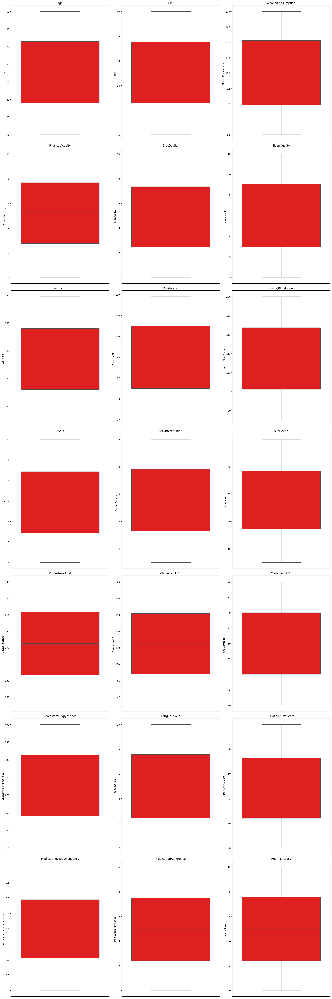

In [ ]:
import warnings
warnings.filterwarnings("ignore")

plt.figure(figsize=(20, 60))

# Grid 7 baris x 3 kolom
for i in range(21):
    plt.subplot(7, 3, i + 1)
    sns.boxplot(y=num_dist.iloc[:, i], color='red')  # Membuat boxplot untuk setiap kolom
    plt.title(num_dist.columns[i])  # Menambahkan judul berdasarkan nama kolom
    plt.tight_layout()

plt.show()

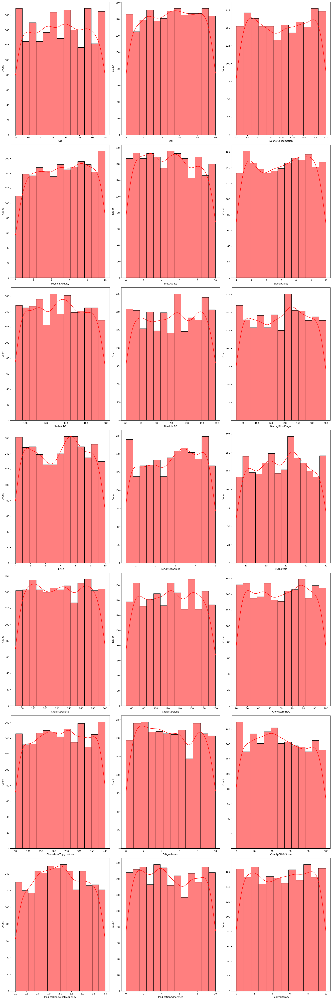

In [ ]:
plt.figure(figsize=(20, 60))

for i in range(21):
    plt.subplot(7, 3, i + 1)
    sns.histplot(num_dist.iloc[:, i], color='red', kde=True)
    plt.tight_layout()

plt.show()

In [ ]:
#categorical_features = [col for col in categorical_features if col not in non_used]
categorical_dist = df[categorical_features]

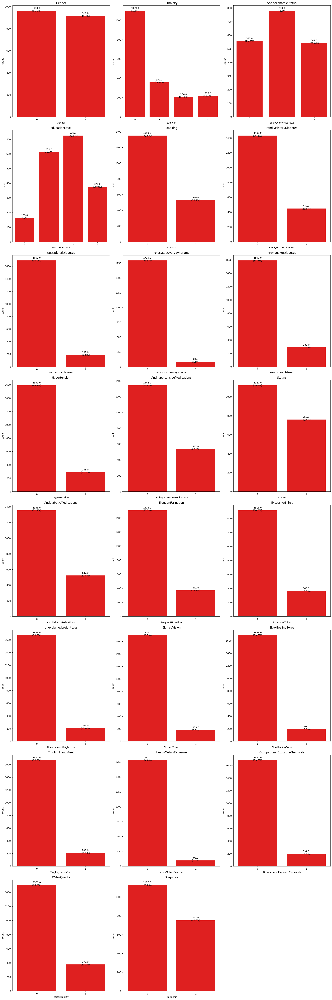

In [ ]:
plt.figure(figsize=(20, 60))

for i in range(23):
    plt.subplot(8, 3, i + 1)

    # Membuat countplot untuk setiap kolom
    ax = sns.countplot(x=categorical_dist.iloc[:, i], color='red')

    # Menambahkan jumlah sampel dan persentasenya
    total = len(categorical_dist)
    for p in ax.patches:
        count = p.get_height()
        percentage = f'{100 * count / total:.1f}%'
        ax.annotate(f'{count}\n({percentage})',
                    (p.get_x() + p.get_width() / 2., count),
                    ha='center', va='center',
                    xytext=(0, 5),
                    textcoords='offset points')

    # Menambahkan judul berdasarkan nama kolom
    plt.title(categorical_dist.columns[i])

    plt.tight_layout()

plt.show()

In [ ]:
categorical_features = [col for col in categorical_features if col not in non_used]
categorical_dist = df[categorical_features]

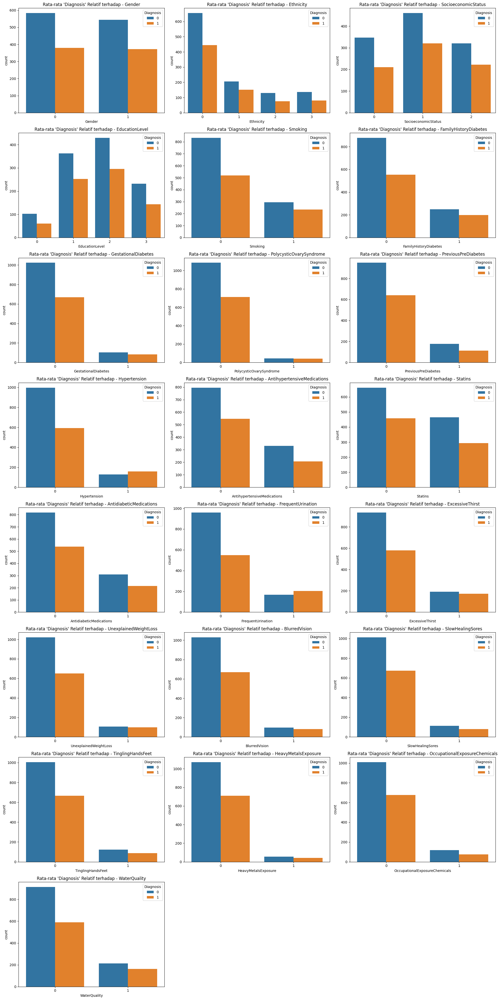

In [ ]:
# Tentukan grid layout
fig, axes = plt.subplots(8, 3, figsize=(20, 40))
axes = axes.flatten()

# Iterasi dan plot
for i, col in enumerate(categorical_dist):
    sns.countplot(x=col, hue='Diagnosis', data=df, ax=axes[i])
    axes[i].set_title(f"Rata-rata 'Diagnosis' Relatif terhadap - {col}")
    axes[i].legend(title='Diagnosis')

for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

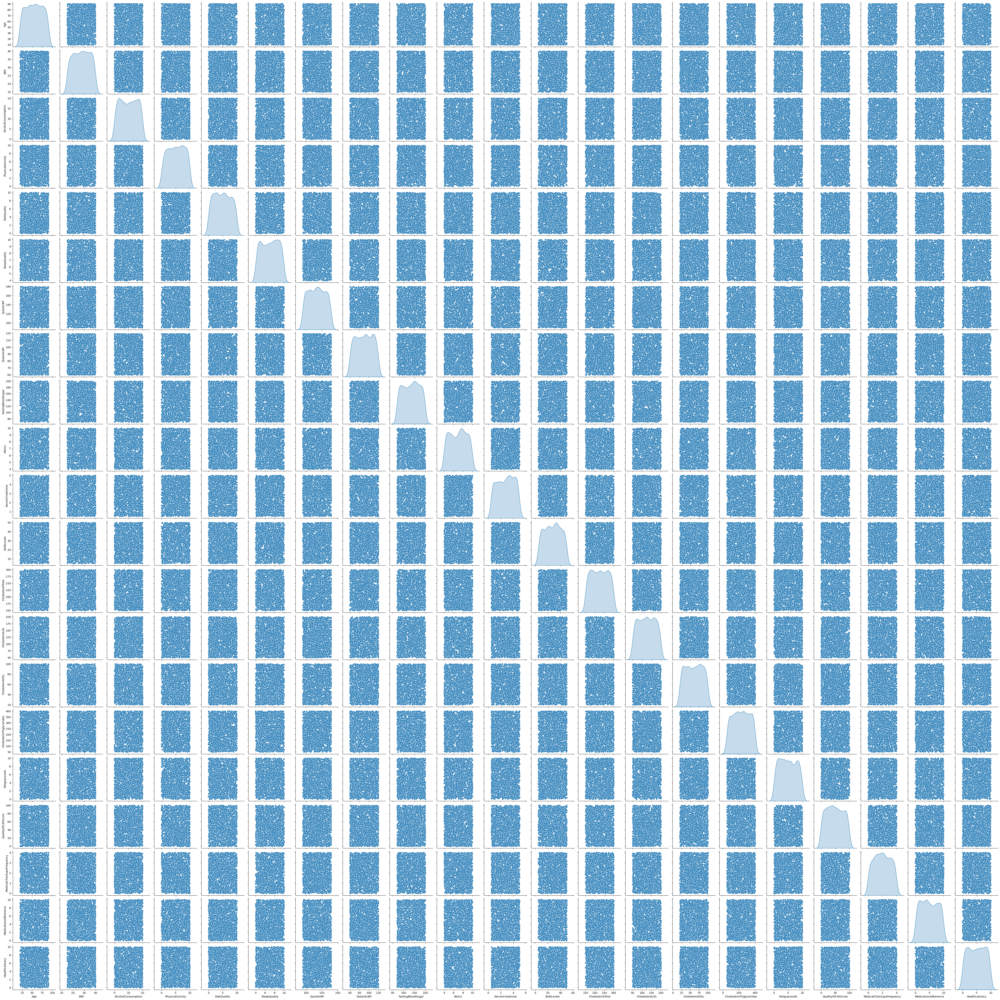

In [ ]:
sns.pairplot(num_dist, diag_kind = 'kde')


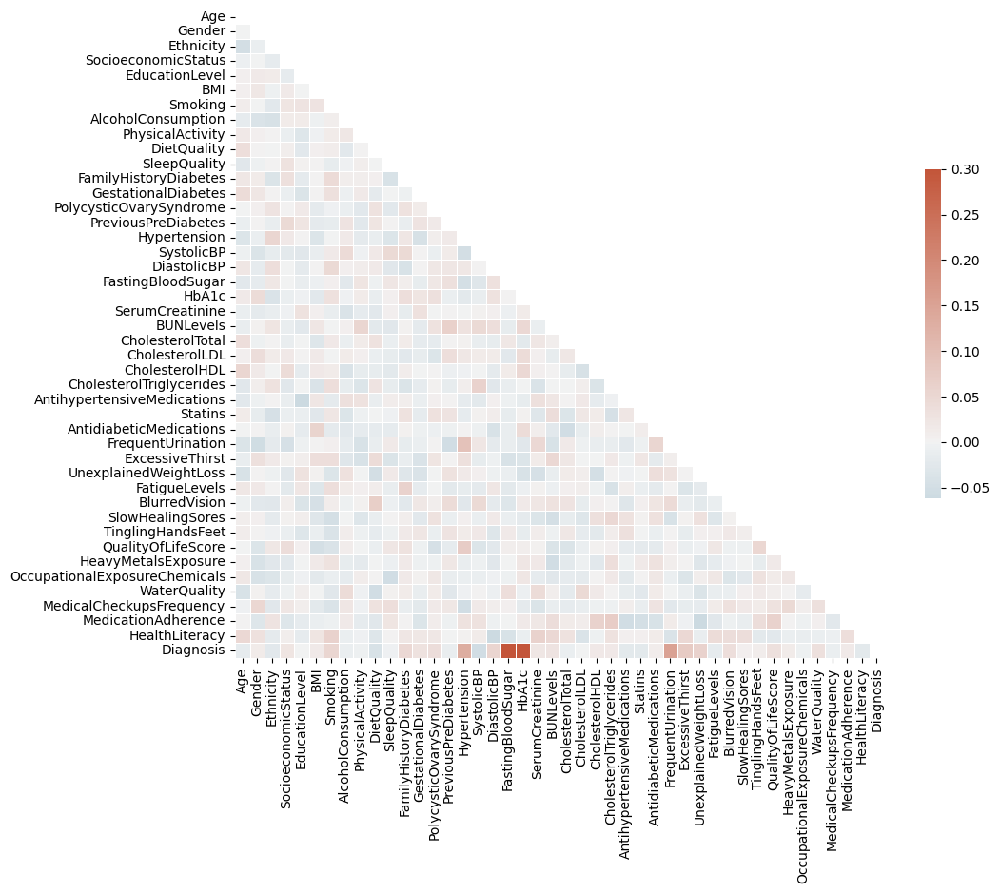

In [ ]:
# Compute the correlation matrix
corr = df.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

plt.show()

In [ ]:
# Compute the correlation matrix
corr = df.corr()

# Tampilkan tabel korelasi sebagai DataFrame
corr_table = pd.DataFrame(corr)

# Display tabel korelasi
corr_table

,Age,Gender,Ethnicity,SocioeconomicStatus,EducationLevel,BMI,Smoking,AlcoholConsumption,PhysicalActivity,DietQuality,...,SlowHealingSores,TinglingHandsFeet,QualityOfLifeScore,HeavyMetalsExposure,OccupationalExposureChemicals,WaterQuality,MedicalCheckupsFrequency,MedicationAdherence,HealthLiteracy,Diagnosis
Age,1.000000,-0.000856,-0.049707,-0.007782,0.005520,0.006928,0.010858,-0.017781,0.017811,0.036613,...,0.008862,0.011553,-0.001543,0.007326,0.019327,-0.039539,-0.003905,0.001905,0.047514,-0.016864
Gender,-0.000856,1.000000,-0.010411,-0.000957,0.014952,0.020455,0.000275,-0.038466,0.006692,0.002963,...,0.006712,0.000386,-0.033461,-0.042018,-0.040498,0.003230,0.049901,-0.031806,0.032218,0.011746
Ethnicity,-0.049707,-0.010411,1.000000,-0.017719,0.012042,-0.005440,-0.022346,-0.042909,0.002575,-0.000708,...,-0.019843,-0.003145,0.018857,-0.025280,-0.034420,-0.016378,-0.025778,0.028130,-0.019020,-0.023132
SocioeconomicStatus,-0.007782,-0.000957,-0.017719,1.000000,-0.017693,0.016979,0.025103,0.012669,-0.009270,0.009887,...,0.003532,-0.009587,0.039302,-0.022591,-0.014755,-0.005197,0.023663,-0.030889,0.008573,0.025572
EducationLevel,0.005520,0.014952,0.012042,-0.017693,1.000000,-0.001963,0.028154,0.011762,-0.030274,-0.022786,...,0.007986,-0.030884,0.004719,-0.001439,-0.003291,0.008046,0.008012,-0.017207,-0.016867,-0.002306
BMI,0.006928,0.020455,-0.005440,0.016979,-0.001963,1.000000,0.025793,-0.006644,-0.003442,0.006032,...,-0.028143,-0.010130,-0.046976,0.016709,-0.021222,-0.001681,-0.021301,-0.009708,0.025464,0.014586
Smoking,0.010858,0.000275,-0.022346,0.025103,0.028154,0.025793,1.000000,0.008090,0.013156,0.010566,...,-0.048083,-0.037035,-0.038300,0.028792,-0.010179,-0.027000,-0.038856,-0.005484,0.058474,0.053829
AlcoholConsumption,-0.017781,-0.038466,-0.042909,0.012669,0.011762,-0.006644,0.008090,1.000000,0.018922,-0.023769,...,-0.001494,0.010282,0.011082,-0.014001,-0.016512,0.040675,0.023039,0.015339,-0.009071,-0.009671
PhysicalActivity,0.017811,0.006692,0.002575,-0.009270,-0.030274,-0.003442,0.013156,0.018922,1.000000,0.001632,...,-0.029537,-0.005920,-0.002444,-0.018844,0.010648,-0.003300,-0.002934,-0.015420,-0.003800,-0.006413
DietQuality,0.036613,0.002963,-0.000708,0.009887,-0.022786,0.006032,0.010566,-0.023769,0.001632,1.000000,...,-0.012224,-0.016799,-0.009517,-0.001049,0.002738,-0.051115,0.029560,-0.026133,-0.029876,-0.041432


In [ ]:
# Misalkan 'target_feature' adalah nama kolom target fitur
target_feature = 'Diagnosis'

# Filter korelasi lemah terhadap target fitur
weak_corr_with_target = corr_table[target_feature][(corr_table[target_feature] > -0.01) & (corr_table[target_feature] < 0.01)]

# Tampilkan hasil
weak_corr_with_target

,Diagnosis
EducationLevel,-0.002306
AlcoholConsumption,-0.009671
PhysicalActivity,-0.006413
SleepQuality,-0.002938
CholesterolLDL,-0.000660
SlowHealingSores,0.006294
OccupationalExposureChemicals,-0.005859
MedicalCheckupsFrequency,-0.009598


In [ ]:
df.drop(['EducationLevel',
        'AlcoholConsumption',
        'PhysicalActivity',
        'SleepQuality',
        'SlowHealingSores',
        'OccupationalExposureChemicals',
        'MedicalCheckupsFrequency'], inplace=True, axis=1)
df.head()

,Age,Gender,Ethnicity,SocioeconomicStatus,BMI,Smoking,DietQuality,FamilyHistoryDiabetes,GestationalDiabetes,PolycysticOvarySyndrome,...,UnexplainedWeightLoss,FatigueLevels,BlurredVision,TinglingHandsFeet,QualityOfLifeScore,HeavyMetalsExposure,WaterQuality,MedicationAdherence,HealthLiteracy,Diagnosis
0,44,0,1,2,32.985284,1,4.898831,1,1,0,...,0,9.534169,0,1,73.765109,0,0,4.486980,7.211349,1
1,51,1,0,1,39.916764,0,8.941093,0,0,0,...,0,0.123214,0,0,91.445753,0,1,5.961705,5.024612,1
2,89,1,0,1,19.782251,0,7.722543,1,0,0,...,0,9.643320,0,0,54.485744,0,0,8.950821,7.034944,0
3,21,1,1,1,32.376881,1,4.804044,1,1,0,...,0,3.403557,0,0,77.866758,0,1,3.124769,4.717774,0
4,27,1,0,1,16.808600,0,2.532756,0,0,0,...,0,2.924687,0,0,37.731808,0,0,6.977741,7.887940,0


In [ ]:
from sklearn.preprocessing import  OneHotEncoder

df = pd.concat([df, pd.get_dummies(df['Ethnicity'], prefix='Ethnicity')],axis=1)
df.drop(['Ethnicity'], axis=1, inplace=True)
df.head()

,Age,Gender,SocioeconomicStatus,BMI,Smoking,DietQuality,FamilyHistoryDiabetes,GestationalDiabetes,PolycysticOvarySyndrome,PreviousPreDiabetes,...,QualityOfLifeScore,HeavyMetalsExposure,WaterQuality,MedicationAdherence,HealthLiteracy,Diagnosis,Ethnicity_0,Ethnicity_1,Ethnicity_2,Ethnicity_3
0,44,0,2,32.985284,1,4.898831,1,1,0,0,...,73.765109,0,0,4.486980,7.211349,1,False,True,False,False
1,51,1,1,39.916764,0,8.941093,0,0,0,0,...,91.445753,0,1,5.961705,5.024612,1,True,False,False,False
2,89,1,1,19.782251,0,7.722543,1,0,0,0,...,54.485744,0,0,8.950821,7.034944,0,True,False,False,False
3,21,1,1,32.376881,1,4.804044,1,1,0,1,...,77.866758,0,1,3.124769,4.717774,0,False,True,False,False
4,27,1,1,16.808600,0,2.532756,0,0,0,0,...,37.731808,0,0,6.977741,7.887940,0,True,False,False,False


In [ ]:
from sklearn.model_selection import train_test_split

X = df.drop(["Diagnosis"],axis =1)
y = df["Diagnosis"]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 42)

In [ ]:
print(f'Total # of sample in whole dataset: {len(X)}')
print(f'Total # of sample in train dataset: {len(X_train)}')
print(f'Total # of sample in test dataset: {len(X_test)}')

Total # of sample in whole dataset: 1879
Total # of sample in train dataset: 1503
Total # of sample in test dataset: 376


In [ ]:
from sklearn.preprocessing import MinMaxScaler

numerical_features = [
    'Age',
    'BMI',
    'DietQuality',
    'SystolicBP',
    'DiastolicBP',
    'FastingBloodSugar',
    'HbA1c',
    'SerumCreatinine',
    'BUNLevels',
    'CholesterolTotal',
    'CholesterolLDL',
    'CholesterolHDL',
    'CholesterolTriglycerides',
    'FatigueLevels',
    'QualityOfLifeScore',
    'MedicationAdherence',
    'HealthLiteracy'
]

scaler = MinMaxScaler()
scaler.fit(X_train[numerical_features])
X_train[numerical_features] = scaler.transform(X_train.loc[:, numerical_features])

X_test[numerical_features] = scaler.transform(X_test.loc[:, numerical_features])

X_train[numerical_features].head()

,Age,BMI,DietQuality,SystolicBP,DiastolicBP,FastingBloodSugar,HbA1c,SerumCreatinine,BUNLevels,CholesterolTotal,CholesterolLDL,CholesterolHDL,CholesterolTriglycerides,FatigueLevels,QualityOfLifeScore,MedicationAdherence,HealthLiteracy
1463,0.257143,0.460757,0.437348,0.606742,0.271186,0.761008,0.105406,0.562606,0.124391,0.676149,0.848549,0.837029,0.929950,0.803271,0.369819,0.355603,0.441664
271,0.671429,0.944405,0.631674,0.224719,0.949153,0.299890,0.742399,0.563133,0.586553,0.047943,0.143047,0.473399,0.834214,0.342801,0.225291,0.990005,0.763215
184,0.742857,0.373794,0.189514,0.168539,0.711864,0.672884,0.710029,0.169412,0.512295,0.589105,0.952963,0.951745,0.580479,0.163537,0.368695,0.365951,0.096443
1824,0.628571,0.995337,0.726646,0.202247,0.847458,0.037945,0.950138,0.927637,0.403819,0.341601,0.439613,0.891431,0.740157,0.594081,0.965011,0.834439,0.445539
244,0.671429,0.546695,0.822174,0.865169,0.474576,0.295101,0.723255,0.720493,0.415431,0.865563,0.388678,0.370193,0.604980,0.444747,0.391912,0.052471,0.588876


In [ ]:
X_train[numerical_features].describe().round(4)


,Age,BMI,DietQuality,SystolicBP,DiastolicBP,FastingBloodSugar,HbA1c,SerumCreatinine,BUNLevels,CholesterolTotal,CholesterolLDL,CholesterolHDL,CholesterolTriglycerides,FatigueLevels,QualityOfLifeScore,MedicationAdherence,HealthLiteracy
count,1503.0000,1503.0000,1503.0000,1503.0000,1503.0000,1503.0000,1503.0000,1503.0000,1503.0000,1503.0000,1503.0000,1503.0000,1503.0000,1503.0000,1503.0000,1503.0000,1503.0000
mean,0.4981,0.5077,0.4925,0.4914,0.5098,0.4996,0.5032,0.5077,0.5053,0.5002,0.4930,0.5000,0.5094,0.4926,0.4836,0.4979,0.5066
std,0.2929,0.2915,0.2860,0.2863,0.2953,0.2895,0.2908,0.2897,0.2858,0.2861,0.2835,0.2895,0.2892,0.2890,0.2889,0.2879,0.2917
min,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
25%,0.2500,0.2491,0.2495,0.2472,0.2542,0.2469,0.2457,0.2573,0.2651,0.2491,0.2520,0.2507,0.2637,0.2389,0.2348,0.2476,0.2455
50%,0.5143,0.5194,0.4968,0.4944,0.5254,0.5038,0.5233,0.5240,0.5152,0.5053,0.4914,0.5015,0.5157,0.4803,0.4741,0.4861,0.5184
75%,0.7571,0.7560,0.7384,0.7303,0.7712,0.7482,0.7471,0.7514,0.7468,0.7434,0.7373,0.7489,0.7550,0.7586,0.7242,0.7424,0.7642
max,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000


In [ ]:
!pip install lazypredict -q

In [ ]:
from lazypredict.Supervised import LazyClassifier
clf = LazyClassifier()
models,predicts = clf.fit(X_train,X_test,y_train,y_test)
print(models.sort_values(by="Accuracy",ascending=False))

  0%|          | 0/32 [00:00<?, ?it/s]

[LightGBM] [Info] Number of positive: 609, number of negative: 894
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000702 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3849
[LightGBM] [Info] Number of data points in the train set: 1503, number of used features: 35
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.405190 -> initscore=-0.383888
[LightGBM] [Info] Start training from score -0.383888
                               Accuracy  Balanced Accuracy  ROC AUC  F1 Score  \
Model                                                                           
AdaBoostClassifier                 0.94               0.93     0.93      0.94   
XGBClassifier                      0.93               0.92     0.92      0.93   
LGBMClassifier                     0.93               0.91     0.91      0.93   
RandomForestClassifier             0.91   

In [ ]:
from xgboost import XGBClassifier
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier

In [ ]:
models = pd.DataFrame(index=['ROC AUC', 'KS'],
                      columns=['XGBClassfier', 'RandomForestClassifier', 'ExtraTreesClassifier'])

In [ ]:
from sklearn.metrics import roc_auc_score
import numpy as np

def evaluate_ks_and_roc_auc(y_true, y_proba):
    """
    Menghitung nilai KS (Kolmogorov-Smirnov) dan ROC AUC
    y_true: label asli (0/1)
    y_proba: probabilitas prediksi (output dari predict_proba)
    """
    auc = roc_auc_score(y_true, y_proba[:,1])  # hanya ambil prob untuk kelas 1
    # hitung nilai KS
    from scipy.stats import ks_2samp
    ks = ks_2samp(y_proba[y_true==0][:,1], y_proba[y_true==1][:,1]).statistic
    return ks, auc


In [ ]:
from sklearn.metrics import classification_report, confusion_matrix

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import itertools

def plot_confusion_matrix(cm, target_names, title='Confusion matrix', cmap=None, normalize=False):
    accuracy = np.trace(cm) / float(np.sum(cm))
    misclass = 1 - accuracy

    if cmap is None:
        cmap = plt.get_cmap('Blues')

    plt.figure(figsize=(8, 6))
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()

    if target_names is not None:
        tick_marks = np.arange(len(target_names))
        plt.xticks(tick_marks, target_names, rotation=45)
        plt.yticks(tick_marks, target_names)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    thresh = cm.max() / 1.5 if normalize else cm.max() / 2
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, "{:,}".format(cm[i, j]),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel(f'Predicted label\naccuracy={accuracy:.4f}; misclass={misclass:.4f}')
    plt.show()


Training is success!
Classification report XGBoost Classifier : 
               precision    recall  f1-score   support

           0       0.92      0.97      0.95       233
           1       0.95      0.87      0.91       143

    accuracy                           0.93       376
   macro avg       0.93      0.92      0.93       376
weighted avg       0.93      0.93      0.93       376



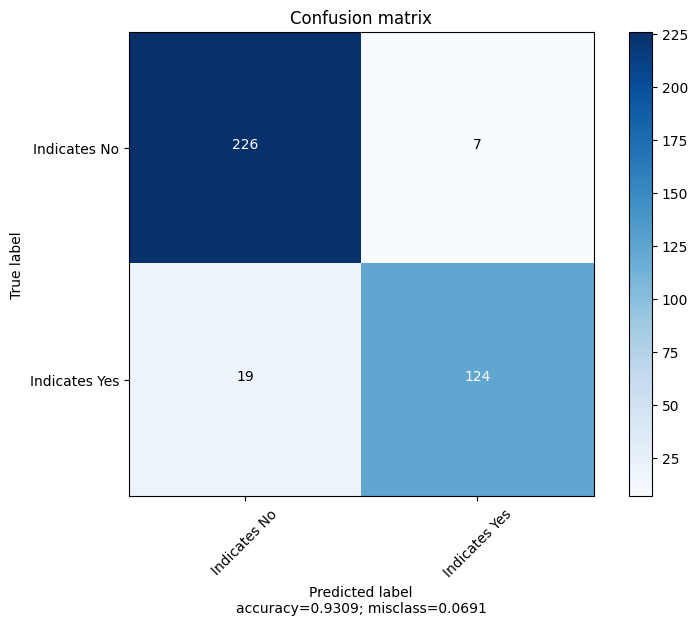

In [ ]:
# Main pipeline for fitting.
model_XGB = XGBClassifier(use_label_encoder=False, eval_metric='logloss')
model_XGB.fit(X_train, y_train)
print("Training is success!")
y_pred = model_XGB.predict_proba(X_test)
predicted = model_XGB.predict(X_test)
#print AUC, KS score, and classification report
ks, auc = evaluate_ks_and_roc_auc(y_test, y_pred)
matrix = classification_report(y_test, predicted)
print('Classification report XGBoost Classifier : \n',matrix)
cm = confusion_matrix(y_test, predicted)
target_names = ["Indicates No","Indicates Yes"]
plot_confusion_matrix(cm, target_names, title='Confusion matrix', cmap=None,normalize=False)

models.loc['ROC AUC','XGBClassfier'] = auc
models.loc['KS','XGBClassfier'] = ks

Training is success!
Classification report RandomForestClassifier : 
               precision    recall  f1-score   support

           0       0.90      0.97      0.94       233
           1       0.95      0.83      0.89       143

    accuracy                           0.92       376
   macro avg       0.93      0.90      0.91       376
weighted avg       0.92      0.92      0.92       376



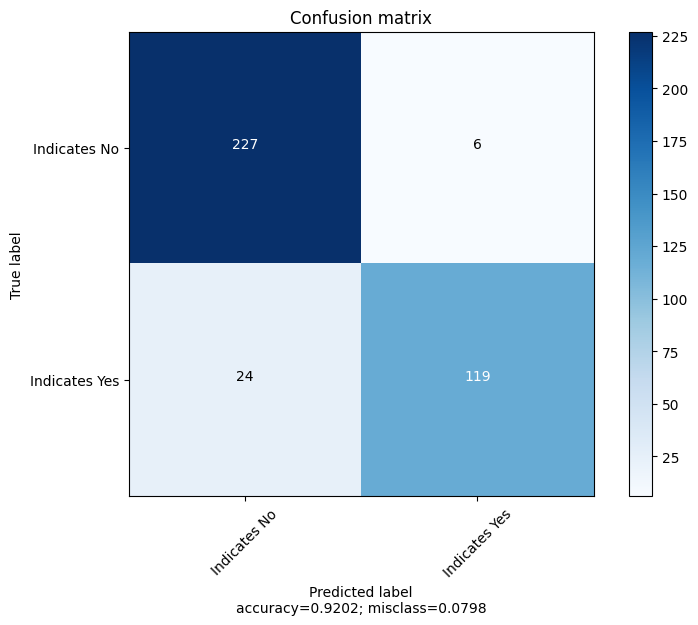

In [ ]:
# Main pipeline for fitting.
model_rf = RandomForestClassifier(max_depth= 20)
model_rf.fit(X_train, y_train)
print("Training is success!")
y_pred = model_rf.predict_proba(X_test)
predicted = model_rf.predict(X_test)
#print AUC, KS score, and classification report
ks, auc = evaluate_ks_and_roc_auc(y_test, y_pred)
matrix = classification_report(y_test, predicted)
print('Classification report RandomForestClassifier : \n',matrix)
cm = confusion_matrix(y_test, predicted)
target_names = ["Indicates No","Indicates Yes"]
plot_confusion_matrix(cm, target_names, title='Confusion matrix', cmap=None,normalize=False)

models.loc['ROC AUC','RandomForestClassifier'] = auc
models.loc['KS','RandomForestClassifier'] = ks

Training is success!
Classification report ExtraTreesClassifier : 
               precision    recall  f1-score   support

           0       0.86      0.96      0.90       233
           1       0.91      0.74      0.82       143

    accuracy                           0.88       376
   macro avg       0.89      0.85      0.86       376
weighted avg       0.88      0.88      0.87       376



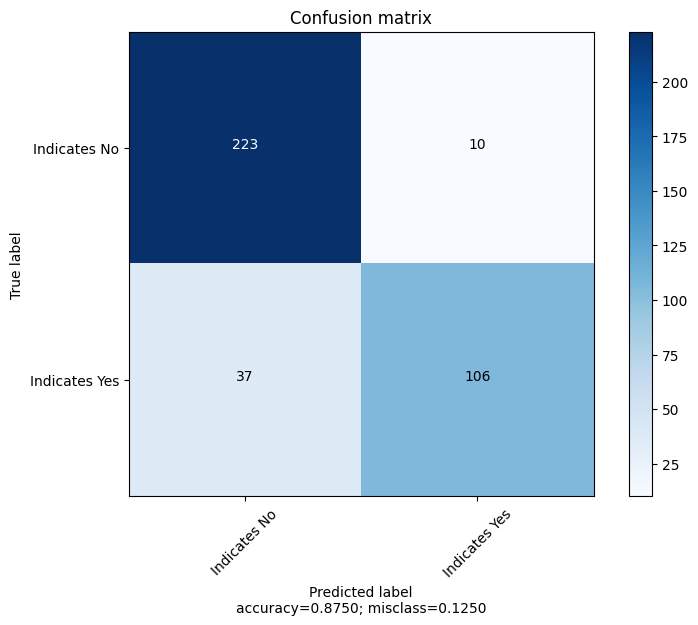

In [ ]:
# Main pipeline for fitting.
model_etc = ExtraTreesClassifier(n_estimators=100, max_depth= 10,n_jobs= 2,random_state= 100)
model_etc.fit(X_train, y_train)
print("Training is success!")
y_pred = model_etc.predict_proba(X_test)
predicted = model_etc.predict(X_test)
#print AUC, KS score, and classification report
ks, auc = evaluate_ks_and_roc_auc(y_test, y_pred)
matrix = classification_report(y_test, predicted)
print('Classification report ExtraTreesClassifier : \n',matrix)
cm = confusion_matrix(y_test, predicted)
target_names = ["Indicates No","Indicates Yes"]
plot_confusion_matrix(cm, target_names, title='Confusion matrix', cmap=None,normalize=False)

models.loc['ROC AUC','ExtraTreesClassifier'] = auc
models.loc['KS','ExtraTreesClassifier'] = ks

(0.8, 1.0)

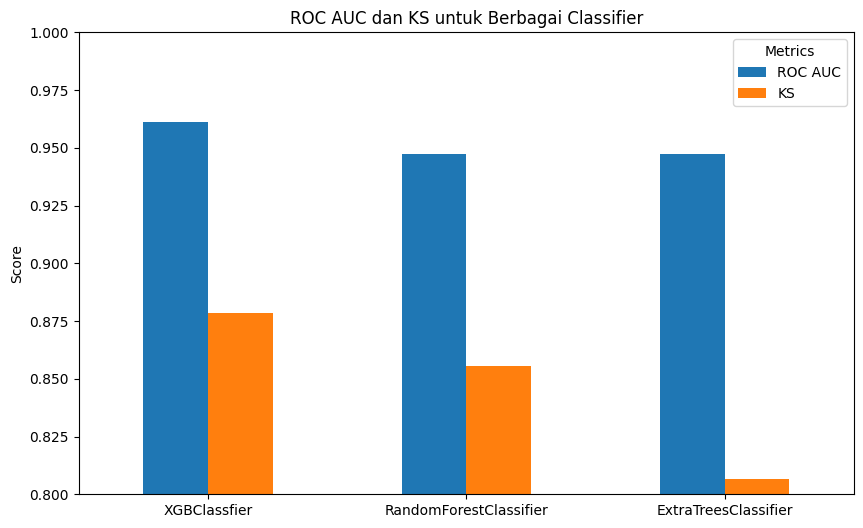

In [ ]:
# Membuat barplot
models.T.plot(kind='bar', figsize=(10, 6))

# Menambahkan judul dan label
plt.title('ROC AUC dan KS untuk Berbagai Classifier')
plt.ylabel('Score')
plt.xticks(rotation=0)
plt.legend(title='Metrics')
plt.ylim(0.8, 1.0)